In [45]:
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns

import sklearn.svm
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split

In [2]:
df = pd.read_pickle('accessible_pois.pkl')

In [8]:
df.head(10)

,id,access,barrier,bicycle,motor_vehicle,opening_hours,wheelchair,lon,lat
99878,99878,permissive,gate,no,no,dawn-dusk,yes,-0.152985,51.524358
104734,104734,None,None,None,None,None,yes,-1.785876,51.565653
106213,106213,None,None,None,None,None,yes,-0.142942,51.525660
108042,108042,None,None,None,None,Mo-We 16:00-23:30; Th-Fr 16:00-01:00; Sa 16:00...,limited,-0.135513,51.523561
251191,251191,None,None,None,None,None,limited,-0.715918,51.115444
262708,262708,None,None,None,None,None,limited,-0.726258,51.024400
262778,262778,None,None,None,None,None,yes,-0.826153,50.990331
271339,271339,None,None,None,None,None,no,-1.856858,51.353526
328762,328762,None,None,None,None,"""Part time""",yes,1.305108,52.626620
367457,367457,None,None,None,None,None,yes,-1.446450,52.984748


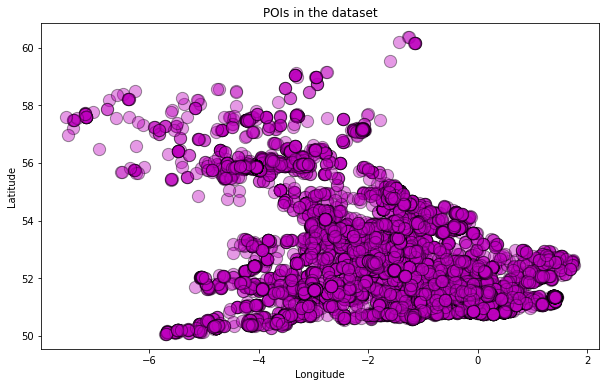

In [51]:
from matplotlib import rc, font_manager
from numpy import arange, cos, pi
from matplotlib.pyplot import figure, axes, plot, xlabel, ylabel, title, \
grid, savefig, show


fig, ax = plt.subplots()

fig.set_size_inches(10, 6)
rs_scatter = ax.scatter(x=df['lon'], y=df['lat'], c='m', edgecolor='k', alpha=.4, s=150)
ticks_font = font_manager.FontProperties(style='normal',
    size=10, weight='normal', stretch='normal')

# set font of tick labels
for label in ax.get_xticklabels():
    label.set_fontproperties(ticks_font)
for label in ax.get_yticklabels():
    label.set_fontproperties(ticks_font)

# set title, axis labels, background color
ax.set_title('POIs in the dataset')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# annotate each of the most visited cities on the map
bbox_style = {'boxstyle':'round', 'color':'k', 'fc':'w', 'alpha':0.8}
arrowprops_style = {'arrowstyle':'->', 'connectionstyle':'arc3,rad=0.5', 'color':'k', 'alpha':0.8}
annotate_cities = lambda row: ax.annotate(row['city'], 
                                          xy=(row['lon'], row['lat']),
                                          xytext=(row['lon'] + 1, row['lat'] + 1),
                                          fontproperties=annotation_font,
                                          bbox=bbox_style,
                                          xycoords='data',
                                          arrowprops=arrowprops_style)
    
plt.show()

In [89]:
import folium
from folium import plugins
centre = (51.5, 1.5)
m = folium.Map([51.5, 1.5], zoom_start=11)

for index, row in df.iterrows():
    folium.CircleMarker([row['lat'], row['lon']],
                        radius=2,
                        fill_color="#3db7e4",
                       ).add_to(m)
    
    
cities = df[['lat', 'lon']].values
m.add_child(plugins.HeatMap(cities, radius=1))
m